<a href="https://colab.research.google.com/github/ayportella/geopandas/blob/main/02_queimadas_folium.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Ocorrências de Queimadas no Estado do Amazonas entre os Meses de Outubro de 2022 e Outubro de 2023**

Andressa Yumi Portella </br>
Outubro de 2023

Esse projeto irá demonstrar o uso das bibliotecas GeoPandas e Folium para manipular dados geoespaciais e interagir com eles a partir de mapas.</br>

Com Folium existe também a possibilidade de criar mapas com marcadores clusterizados, que são muito úteis para visualização de muitos dados em navegadores, e para ter ideia de agrupamento de ocorrências por proximidade , e mapas de calor.

Os dados de queimadas foram retirados do BDQueimadas, do site do [INPE](http://terrabrasilis.dpi.inpe.br/queimadas/bdqueimadas/). Foram extraídas as ocorrências entre ínício de outubro de 2022 a início de outubro de 2023 do estado do Amazonas, a fim de simplificação.

Desse mesmo [site](http://terrabrasilis.dpi.inpe.br/queimadas/bdqueimadas/), foram extraídos o shapefile dos estados correspondentes à Amazônia Legal, sendo eles: Amazonas, Acre, Rondônia, Roraima, Pará, Maranhão, Amapá, Tocantins e Mato Grosso.

Os dados de municípios são provenientes do site do [IBGE](https://www.ibge.gov.br/geociencias/organizacao-do-territorio/malhas-territoriais/15774-malhas.html).

In [1]:
#instalando a biblioteca folium
!pip install folium

In [28]:
import pandas as pd
import geopandas as gpd
import folium

In [5]:
# criando um mapa simples com o folium
fmap = folium.Map()
fmap

In [42]:
#carregando dados de queimadas
gdf_queimadas = gpd.read_file('focos_qmd_inpe_20221001_20231001.shp', driver='shapefile')

#carregando estados da amazonia legal
gdf_estados_amazonia_legal = gpd.read_file('states_legal_amazon.shp',driver='shapefile')

In [49]:
gdf_queimadas.to_file('queimadas.json', driver='GeoJSON')

In [10]:
gdf_queimadas.head(3)

,DataHora,Satelite,Pais,Estado,Municipio,Bioma,DiaSemChuv,Precipitac,RiscoFogo,Latitude,Longitude,FRP,geometry
0,2022/10/01 18:19:00,AQUA_M-T,Brasil,AMAZONAS,BOCA DO ACRE,Amazônia,0.0,0.0,0.03,-9.17578,-68.28486,34.3,POINT (-68.28486 -9.17578)
1,2022/10/01 18:19:00,AQUA_M-T,Brasil,AMAZONAS,BOCA DO ACRE,Amazônia,0.0,0.0,0.01,-9.17588,-68.34938,10.9,POINT (-68.34938 -9.17588)
2,2022/10/01 18:19:00,AQUA_M-T,Brasil,AMAZONAS,BOCA DO ACRE,Amazônia,0.0,0.0,0.06,-9.17708,-68.29388,55.0,POINT (-68.29388 -9.17708)


In [110]:
gdf_estados_amazonia_legal

,id,nome,sigla,geocodigo,geometry
0,2,Rondônia,RO,11,"MULTIPOLYGON (((-60.71438 -13.69188, -60.72165..."
1,3,Acre,AC,12,"MULTIPOLYGON (((-66.62515 -9.90290, -66.62446 ..."
2,4,Amazonas,AM,13,"MULTIPOLYGON (((-73.78698 -7.09645, -73.73817 ..."
3,5,Roraima,RR,14,"MULTIPOLYGON (((-63.37171 2.21232, -63.37086 2..."
4,6,Pará,PA,15,"MULTIPOLYGON (((-58.89539 1.22830, -58.89500 1..."
5,7,Amapá,AP,16,"MULTIPOLYGON (((-54.87194 2.43435, -54.87178 2..."
6,8,Tocantins,TO,17,"POLYGON ((-45.93767 -10.25589, -45.87883 -10.2..."
7,14,Mato Grosso,MT,51,"MULTIPOLYGON (((-50.50981 -12.86237, -50.50174..."
8,26,Maranhão,MA,21,"MULTIPOLYGON (((-44.04109 -2.48442, -44.03955 ..."


O dado extraído possui aproximadamente 17000 ocorrências de queimadas entre outubro de 2022 a outubro de 2023, e renderizar isso num notebook é inviável. Por isso, escolheremos apenas as 100 primeiras ocorrências para ter uma ideia de como fica a visualização no Folium em um primeiro momento.

In [60]:
gdf_queimadas_slice= gdf_queimadas.iloc[:100]

fmap = folium.Map()

feat_geojson = folium.features.GeoJson(gdf_queimadas_slice)

fmap.add_child(feat_geojson)

fmap


In [64]:
#melhorando a visualização adicionando um ponto médio das queimadas, assim o mapa abre num local mais representativo

media_latitude = gdf_queimadas_slice['Latitude'].mean()
media_longitude = gdf_queimadas_slice['Longitude'].mean()

fmap = folium.Map(location=[media_latitude, media_longitude])

feat_geojson = folium.features.GeoJson(gdf_queimadas_slice)

fmap.add_child(feat_geojson)

fmap


Essas 100 primeiras ocorrências foram registradas majoritariamente nessa região da fronteira entre os estados do Acre e Amazonas, por isso o mapa abriu nessa localização.

**Mas e se quisermos ver todas as ocorrências registradas para esse ano, como tornar isso possível?**

In [65]:
from folium.plugins import FastMarkerCluster

In [66]:
fmap = folium.Map(location=[media_latitude, media_longitude])

mc = FastMarkerCluster(gdf_queimadas[['Latitude', 'Longitude']])

fmap.add_child(mc)

fmap

Podemos perceber a clusterização dos dados com a visualização dinâmica, em que as ocorrências podem ser mais dispersas ou mais agrupadas a depender de aproximação ou afastamento escolhido.

Existem mais ocorrências de queimadas próximas às capitais Rio Branco, Porto Velho, Manaus e regiões de fronteiras.</br>
Ao vermos com mais detalhe, as principais ocorrências estão em localidades próximas a rios e a rodovias, em que existem maior nível populacional e acesso de pessoas.</br>
Em contrapartida, há menos ocorrências em reservas, mas ainda assim é possível notar ocorrências.

In [68]:
gdf_estados_amazonia_legal.to_file('amazonia_legal.json', driver='GeoJSON')

In [109]:
# adicionando os limites dos estados da Amazônia Legal ao mapa anterior de clusterização de ocorrências de queimadas
fmap = folium.Map(location=[media_latitude, media_longitude])

limites = folium.features.GeoJson(gdf_estados_amazonia_legal,
                                  style_function=lambda feature: {
                                      'color': 'black',
                                      'weight': 2,
                                      'fillOpacity': 0.0
                                  })
fmap.add_child(limites)

mc = FastMarkerCluster(gdf_queimadas[['Latitude', 'Longitude']])

fmap.add_child(mc)

fmap

Esse mapa pode ser salvo em html. Isso permite você enviar o arquivo para outra pessoa para que ela visualize no navegador, por exemplo.

In [75]:
# salvando o mapa em arquivo html

fmap.save('mapa_queimadas.html')

**Criando Mapas de Calor (HeatMaps)**

In [77]:
# importando o plugin HeatMap
from folium.plugins import HeatMap

In [78]:
fmap = folium.Map(location=[media_latitude, media_longitude])

heat_map = HeatMap(gdf_queimadas[['Latitude', 'Longitude']])

fmap.add_child(heat_map)

fmap

In [79]:
# salvando também em html
fmap.save("heatmap_queimadas.html")

**Adicionando informações estatísticas ao mapa por município**

In [85]:
#carregando os municipios de Amazonas
gdf_municipios_am_gsp = gpd.read_file('AM_Municipios_2022.shp', driver='shapefile')

#carregando os dados de queimadas
gdf_queimadas_gsp = gpd.read_file('queimadas.json', drive="GeoJSON")


In [86]:
gdf_municipios_am_gsp.head(3)

,CD_MUN,NM_MUN,SIGLA_UF,AREA_KM2,geometry
0,1300029,Alvarães,AM,5923.461,"POLYGON ((-64.71229 -3.27608, -64.71620 -3.276..."
1,1300060,Amaturá,AM,4754.109,"POLYGON ((-67.94285 -3.32959, -67.87343 -3.332..."
2,1300086,Anamã,AM,2446.121,"POLYGON ((-61.51715 -3.68480, -61.54102 -3.684..."


In [88]:
#contando a quantidade de dados em cada município e salvando em uma coluna
for index, municipio in gdf_municipios_am_gsp.iterrows():
  qtd_queimadas = len(gdf_queimadas_gsp[gdf_queimadas_gsp.intersects(municipio.geometry)])
  gdf_municipios_am_gsp.loc[index,'qtd_queimadas'] = qtd_queimadas

In [89]:
gdf_municipios_am_gsp.head(3)

,CD_MUN,NM_MUN,SIGLA_UF,AREA_KM2,geometry,qtd_queimadas
0,1300029,Alvarães,AM,5923.461,"POLYGON ((-64.71229 -3.27608, -64.71620 -3.276...",303.0
1,1300060,Amaturá,AM,4754.109,"POLYGON ((-67.94285 -3.32959, -67.87343 -3.332...",23.0
2,1300086,Anamã,AM,2446.121,"POLYGON ((-61.51715 -3.68480, -61.54102 -3.684...",56.0


In [108]:
media_latitude_gsp = gdf_queimadas_gsp['Latitude'].mean()
media_longitude_gsp = gdf_queimadas_gsp['Longitude'].mean()

fmap = folium.Map(lotation=[media_latitude, media_longitude])

for _, municipio in gdf_municipios_am_gsp.iterrows():
  municipio_geojson = folium.features.GeoJson(municipio.geometry,
                                              style_function = lambda feature: {
                                                 'color': 'blue',
                                                 'weight': 2,
                                                 'fillOpacity': 0.1
                                              })
  popup = folium.Popup("""
                          Município: {} <br>
                          Queimadas Registradas: {}
                          """. format(municipio.NM_MUN, str(int(municipio.qtd_queimadas))), maxwidth=300)
  popup.add_to(municipio_geojson)
  municipio_geojson.add_to(fmap)
  fmap.save('qtd_queimadas_am.html')

fmap



**Quais são os municípios do Amazonas com maior ocorrência de queimadas?**

Esta é apenas uma maneira de visualizar melhor sem precisar interagir com o mapa.

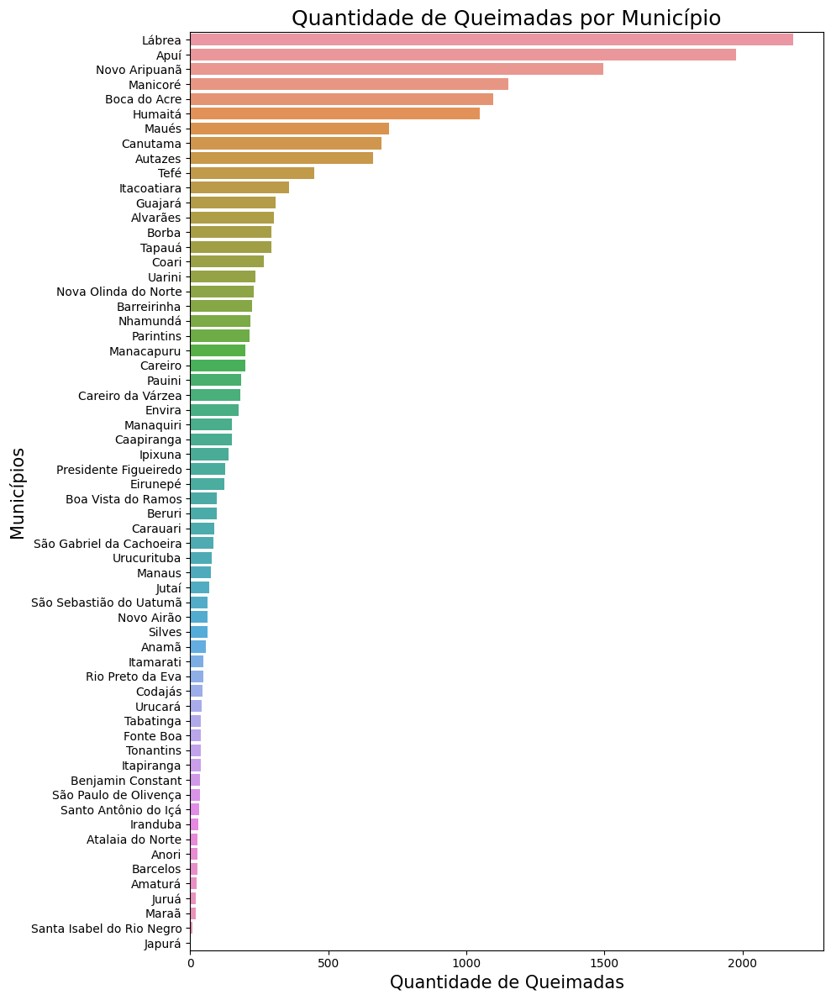

In [107]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,12))
sns.barplot(x='qtd_queimadas',
            y="NM_MUN",
            data=gdf_municipios_am_gsp,
            order=gdf_municipios_am_gsp.sort_values('qtd_queimadas',ascending= False).NM_MUN)
plt.xlabel("Quantidade de Queimadas", size=15)
plt.ylabel("Municípios", size=15)
plt.title("Quantidade de Queimadas por Município", size=18)
plt.tight_layout()




#with sns.axes_style('whitegrid'):
  #plt.subplots(figsize=(10,16))
  #grafico = sns.barplot(data=gdf_municipios_am_gsp, x='qtd_queimadas', y="NM_MUN", order=gdf_municipios_am_gsp('qtd_queimadas'), ci=None, palette="bright")
  #grafico.set(title='Quantidade de Queimadas Por Município', xlabel='Quantidade de Queimadas entre Out/2022 a Out 2023', ylabel='Município')

**Conclusões**

*   As bibliotecas Folium e GeoPandas são muito efetivas para trabalhar com dados geoespaciais e manipular dados em mapas interativos;
*   Existem mais ocorrências de queimadas próximas às capitais Rio Branco, Porto Velho, Manaus e regiões de fronteiras;
*   Ao vermos com mais detalhe, as principais ocorrências estão em localidades próximas a rios e a rodovias, em que existem maior nível populacional e acesso de pessoas;
*   Em contrapartida, há menos ocorrências em reservas, mas ainda assim é possível notá-las;
*   Temos um número expressivo de queimadas nos municípios de Lábrea, Apuí e Nova Aripuanã, com mais de 1500 ocorrências aproximadamente cada um no período em consideração.

